## Vital Elements of Calculus Series

# Part 5: Higher order derivatives

In previous posts we have seen how we can compute formula for the derivative of a generic function constructed out of elementary functions and operations, and that this derivative too is a generic function constructed out of elementary functions / operations. Because the derivative is a generic function it is natural to ask - what happens if we take *its* derivative?  By the same logic and rules, we should be able to compute it in a similar manner, and for the same reasons it too should be a generic function with known equation.  In turn we should then be able to compute the derivative of this formula, and so on ad infinitum.  

These 'derivatives of derivatives' are referred to commonly as *higher order derivatives*, and are the subject of this post.

In [2]:
# imports from custom library
import sys
sys.path.append('../../')
import autograd.numpy as np
import matplotlib.pyplot as plt
from mlrefined_libraries import calculus_library as calclib
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# 1.  Higher order derivatives 

If the derivative of a function with an equation is itself an equation, then we can take the derivative of the derivative.  Lets start off by looking at a few examples to get a sense of how this works, and some of the new notation we will use to denote higher order derivatives.  Afterwards we can see how to use the Automatic Differentiation calculator we discussed in the previous post to compute derivatives of any order.

## 1.1 Higher order derivatives by example

This Section will heavily rely on the derivative formulae/rules from [the previous post]().

#### <span style="color:#a50e3e;">Example. </span> Higher order derivatives of $g(w) = w^4$

Right away we can use the power rule here to write out the first derivative as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = 4\cdot w^3
$$

But of course the derivate here is just another monomial - and we can compute its derivative just as easily as we did $g(w)$ to begin with.  With the understanding that $\frac{\mathrm{d}}{\mathrm{d}w}g(w)$ is a function with known equation given above, we can compute the second derivative just as easily 

$$
\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right) = 3\cdot4\cdot w^2
$$

And we can of course take the derivative of this as well using the same rules, doing so we get

$$
\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right)\right) = 2\cdot3\cdot4\cdot w
$$

which is the *third derivative*.  One more time?  Using the same derivative rules we can compute the *fourth derivative* here which is 

$$
\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right)\right)\right) = 1\cdot2\cdot3\cdot4
$$

In the next Python cell we plot the original function, along with its first three derivatives.

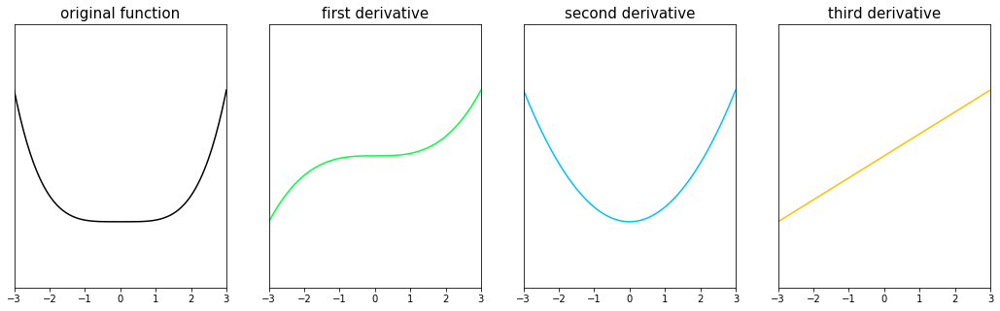

In [3]:
# what function should we play with?  Defined in the next line.
g = lambda w: w**4

# create an instance of the visualizer with this function 
der_viz = calclib.display_derivative_functions.visualizer(g = g)

# run the visualizer for our chosen input function
der_viz.draw_it()

---

An important note on notation - typically higher order derivatives are expressed using more compact notation than given above.  For example, the second derivative is very often denoted more compactly using the following notation

$$
\frac{\mathrm{d^2}}{\mathrm{d}w^2}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right)
$$

Likewise the third derivative is often denoted more compactly as 

$$
\frac{\mathrm{d^3}}{\mathrm{d}w^3}g(w) = \frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}g(w)\right)\right)
$$

and in general the $n^{th}$ order derivative is written as

$$
\frac{\mathrm{d^n}}{\mathrm{d}w^n}g(w) 
$$

> Notation for the derivative of order $n$: $\frac{\mathrm{d^n}}{\mathrm{d}w^n}g(w) $

#### <span style="color:#a50e3e;">Example. </span> Higher order derivatives of $g(w)=\text{cos}(3w) + w^2 + w^3$

Using the derivative formulae and rules from the previous post as well as the compact higher order derivative notation introduced in the previous example, we can write out the first three derivatives explicitly as 




\begin{array}
\
\frac{\mathrm{d}}{\mathrm{d}w}g(w) = -3\text{sin}(3w) + 2w + 3w^2\\
\frac{\mathrm{d^2}}{\mathrm{d}w^2}g(w) = -9\text{cos}(3w) + 2 + 6w\\
\frac{\mathrm{d^3}}{\mathrm{d}w^3}g(w) = 27\text{sin}(3w) + 6\\
\end{array}


We plot these derivatives - along with the original function - in the next Python cell.

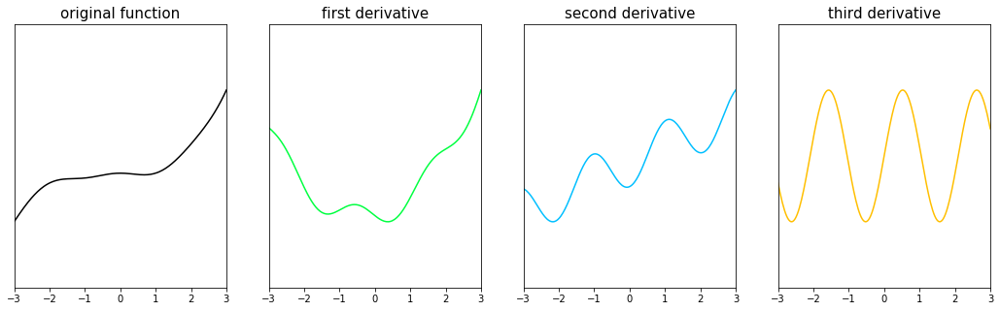

In [6]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.cos(3*w) + w**2 + w**3

# create an instance of the visualizer with this function 
der_viz = calclib.display_derivative_functions.visualizer(g = g)

# run the visualizer for our chosen input function
der_viz.draw_it()

# 2  Automatic Differentiation of higher order derivative values

In this Section we discuss the small number of adjustments to the Automatic Differentiation (AD) paradigm [discussed in the previous post]() we must make in order to compute higher order derivatives using a *forward mode* AD.  

## 2.1 Information flow and construction of the computation graph

As with the original AD algorithm, this implementation constructs the computation graph of a function *implicitly*.  Computations still flows forward through the graph, with the only difference being that it is the higher order derivatives that flow forward.  We illustrate this with a few now standard example functions below.

#### <span style="color:#a50e3e;">Example. </span> Higher order derivative calculations of $g(w) = \text{sin}(w^3)$going  forwards through the computation graph

Lets look at how computation flows on the graph of this function when calculating higher order derivatives.  First, we plot the simple computation graph decomposing this equation.

<p><img src="../../mlrefined_images/calculus_images/computation_graph_1.png" width="45%" height="auto"></p>

We begin by looking at how the second order derivative  $\frac{\mathrm{d}^2}{\mathrm{d}w^2}g(w) = \frac{\mathrm{d}^2}{\mathrm{d}w^2}b(a)$ is computed on the graph.

Starting at node $a$ we compute the first and second order derivatives with respect to $w$.  Since $a(w) = w^3$ the first and second derivatives are directly given by recursively applying the power rule in Table 1 as 

\begin{array}
\
\frac{\mathrm{d}}{\mathrm{d}w}a(w) = 3\times w^2 \\
\frac{\mathrm{d}^2}{\mathrm{d}w^2}a(w) = 3\times 2 \times w = 6w\\
\end{array}

Moving forward on the graph we are now at node $b$, where we need to again compute the first and second derivatives with respect to $w$.  As usual with the first derivative we must use the chain rule from Table 2, writing the derivative formally as 

$$
\frac{\mathrm{d}}{\mathrm{d}w}b(a) = \frac{\mathrm{d}}{\mathrm{d}a}b(a)\frac{\mathrm{d}}{\mathrm{d}w}a(w)  \\
$$

To compute the formal value of this derivative we need only use the lookup table to compute $\frac{\mathrm{d}}{\mathrm{d}a}b(a) = \text{cos}(a)=\text{cos}(w^3)$, and since we have already computed $\frac{\mathrm{d}}{\mathrm{d}w}a(w)$ we have

$$
\frac{\mathrm{d}}{\mathrm{d}w}b(a) = 3\text{cos}(w^3)w^2
$$

Now, notice that taking the second derivative means taking the derivative of a *product of two functions of $w$*, i.e., $\frac{\mathrm{d}}{\mathrm{d}a}b(a)$ and $\frac{\mathrm{d}}{\mathrm{d}w}a(w)$ and so we must use the product rule.  Writing out the derivative using the product rule we have

$$
\frac{\mathrm{d}^2}{\mathrm{d}w^2}b(a) = \frac{\mathrm{d}}{\mathrm{d}a}b(a)\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}w}a(w)\right) + \frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}a}b(a)\right)\frac{\mathrm{d}}{\mathrm{d}w}a(w)
$$

However once again we have already computed all but one of the quantities on the right hand side above $\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}a}b(a)\right)$, which to compute we use the chain rule

$$
\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}a}b(a)\right) = \frac{\mathrm{d}^2}{\mathrm{d}a^2}b(a)\frac{\mathrm{d}}{\mathrm{d}w}a(w)
$$

Then since we can easily compute $\frac{\mathrm{d}^2}{\mathrm{d}a^2}b(a) = -\text{sin}(a)$ and we already have $\frac{\mathrm{d}}{\mathrm{d}w}a(w) = 3w^2$ together we have $\frac{\mathrm{d}}{\mathrm{d}w}\left(\frac{\mathrm{d}}{\mathrm{d}a}b(a)\right) = -\text{sin}(w^3)3w^2$.

With this computation complete we have 

$$
\frac{\mathrm{d}^2}{\mathrm{d}w^2}b(a) =  \text{cos}(w^3)\times 6w -\text{sin}(w^3)3w^2 \times 3w^2
$$

#### <span style="color:#a50e3e;">Example. </span> Higher order derivative calculations of $g(w) = \text{sin}(w^3)$going  forwards through the computation graph

In [37]:
class MyTuple:
    '''
    The basic object manipulated by an AD calculator
    Instances of this class is a tuple containining one 
    function/derivative evaluation.
    '''
    def __init__(self,**kwargs):
        # variables for the value (val) and derivative (der) of our input function 
        self.val = 0
        self.der = 1    
                
        # re-assign these default values 
        if 'val' in kwargs:
            self.val = kwargs['val']
        if 'der' in kwargs:
            self.der = kwargs['der']

# make element capable or desired order           
def choose_order(order,**kwargs):
    # initialize first 
    w = MyTuple()
    if 'val' in kwargs:
        w = MyTuple(val = kwargs['val'])
        
    # recurse to create higher order derivative object
    for i in range(order-1):
        w = MyTuple(val = w)
    return(w)      

#### <span style="color:#a50e3e;">Example. </span> Various table 2 formuilae

In [40]:
# our implementation of the addition rules from Table 2
def multiply(a,b):
    # Create output evaluation and derivative object
    c = MyTuple()

    # switch to determine if a or b is a constant
    if type(a) != MyTuple:
        c.val = a*b.val
        c.der = a*b.der
    elif type(b) != MyTuple:
        c.val = a.val*b
        c.der = a.der*b

    else: # both inputs are MyTuple objects
        c.val = a.val*b.val
        c.der = a.der*b.val + a.val*b.der     # product rule
    
    # Return updated object
    return c

In [41]:
# our implementation of the addition rules from Table 2
def add(a,b):
    # Create output evaluation and derivative object
    c = MyTuple()
    
    # switch to determine if a or b is a constant
    if type(a) != MyTuple:
        c.val = a + b.val
        c.der = b.der
    elif type(b) != MyTuple:
        c.val = a.val + b
        c.der = a.der
    else: # both inputs are MyTuple objects
        c.val = a.val + b.val
        c.der = a.der + b.der
    
    # Return updated object
    return c

In [42]:
# our implementation of the addition rules from Table 2
def subtract(a,b):
    # Create output evaluation and derivative object
    c = MyTuple()
    
    # switch to determine if a or b is a constant
    if type(a) != MyTuple:
        c.val = a - b.val
        c.der = b.der
    elif type(b) != MyTuple:
        c.val = a.val - b
        c.der = a.der
    else: # both inputs are MyTuple objects
        c.val = a.val - b.val
        c.der = a.der - b.der
    
    # Return updated object
    return c

In [43]:
# define negation
def negate(a):
    # Create output evaluation and derivative object
    b = MyTuple()
    b.val = -a.val
    b.der = -a.der
    return b

In [44]:
# our implementation of the power rule from Table 1 
def power(a,n):
    # Create output evaluation and derivative object
    b = MyTuple()
    
    # Produce new function value
    b.val = a.val**n

    # Produce new derivative value
    b.der = n*(a.val**(n-1))*a.der
    
    # Return updated object
    return b

In [46]:
# this next line overloads the addition operator for our MyTuple objects, or in other words adds the 'add' function to our MyTuple class definition on the fly
MyTuple.__add__ = add

# overload the reverse direction so that a + b = b + a
MyTuple.__radd__ = add

# this next line overloads the subtraction operator for our MyTuple objects, or in other words adds the 'add' function to our MyTuple class definition on the fly
MyTuple.__sub__ = subtract

# overload the reverse direction so that a + b = b + a
MyTuple.__rsub__ = subtract

# create two MyTuple objects and try to use Python's built in function assigned to the * operator on them
MyTuple.__mul__ = multiply

# overload the 'reverse multiplication' so that a*b = b*a
MyTuple.__rmul__ = multiply    

# create two MyTuple objects and try to use Python's built in function assigned to the ** operator on them
MyTuple.__pow__ = power

# create two MyTuple objects and try to use Python's built in function assigned to the ** operator on them
MyTuple.__neg__ = negate

#### <span style="color:#a50e3e;">Example. </span> Computing the derivative of $g(w) = \text{sin}(w)$

In [52]:
# our homemade sine function - made general to accept a function as input (hence the explicit application of the chain rule)
def sin(a):
    # Create output evaluation and derivative object
    b = MyTuple()
    
    # check if .val is constant, then last derivative to evaluate
    if type(a.val) != MyTuple:        
        # Calculate new current value
        b.val = np.sin(a.val)

        # Calculate new current derivative value
        b.der = np.cos(a.val)*a.der
    else:
        # Calculate new current value
        b.val = sin(a.val)

        # Calculate new current derivative value
        b.der = cos(a.val)*a.der

    # Return updated object
    return b

In [53]:
# our homemade sine function - made general to accept a function as input (hence the explicit application of the chain rule)
def cos(a):
    # Create output evaluation and derivative object
    b = MyTuple()
    
    # check if .val is constant, then last derivative to evaluate
    if type(a.val) != MyTuple:        
        # Calculate new current value
        b.val = np.cos(a.val)

        # Calculate new current derivative value
        b.der = -np.sin(a.val)*a.der
    else:
        # Calculate new current value
        b.val = cos(a.val)

        # Calculate new current derivative value
        b.der = -sin(a.val)*a.der

    # Return updated object
    return b

In [54]:
# our implementation of the power rule from Table 1 
def tanh(a):
    # Create output evaluation and derivative object
    b = MyTuple()
    
    # check if .val is constant, then last derivative to evaluate
    if type(a.val) != MyTuple:        
        # Calculate new current value
        b.val = np.tanh(a.val)

        # Calculate new current derivative value
        b.der = (1 - np.tanh(a.val)**2)*a.der
    else:
        # Calculate new current value
        b.val = tanh(a.val)

        # Calculate new current derivative value
        b.der = (1 - tanh(a.val)**2)*a.der
    
    # Return updated object
    return b

In [72]:
# our implementation of the power rule from Table 1 
def log(a):
    # Create output evaluation and derivative object
    b = MyTuple()
    
    # check if .val is constant, then last derivative to evaluate
    if type(a.val) != MyTuple:        
        # Calculate new current value
        b.val = np.log(a.val)

        # Calculate new current derivative value
        b.der = a.val**(-1)*a.der
    else:
        # Calculate new current value
        b.val = log(a.val)

        # Calculate new current derivative value
        b.der = a.val**(-1)*a.der
    
    # Return updated object
    return b

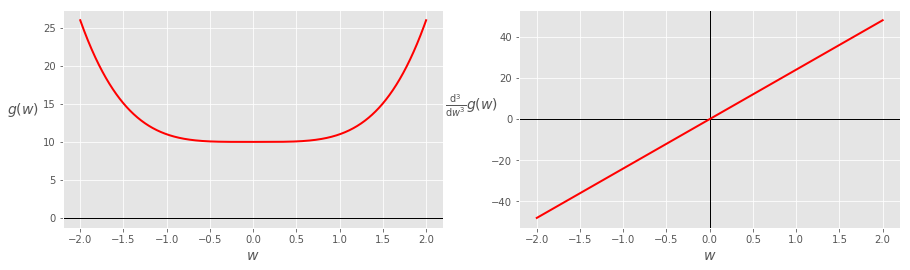

In [94]:
# create instance of our function to differentiate - notice this uses our homemade sine function not numpy's
g = lambda w: w**4 + 10
w = np.linspace(-2,2,1000)

# use the custom plotting function above to plot over a large range of inputs
calclib.plotter.ad_derval_plot(MyTuple,g,w=w,order=3)

## Quadratic approximation

Akin to taking the best linear approximation to $g$ at a point $w_0$, what if we want the next more complicated approximation: a quadratic?

Lets go back and re-derive the linear approximation.  What did we want there?

We could have said what we wanted was a function $h(w)$ where

1.  $h(w_0) = g(w_0)$
2.  $h^{\prime}(w_0) = g^{\prime}(w_0)$

Then the linear approximation certainly satisfies that

\begin{equation}
h(w) = g(w_0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w_0)(w - w_0)
\end{equation}


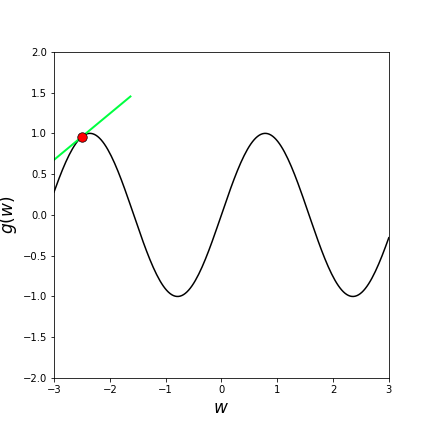
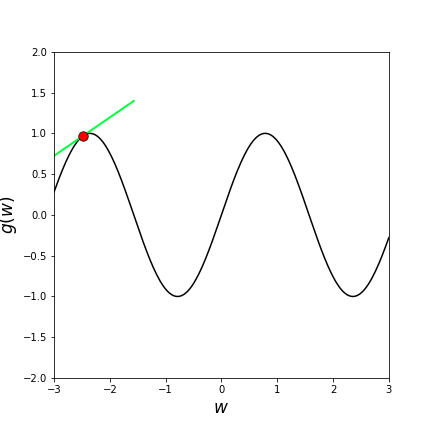
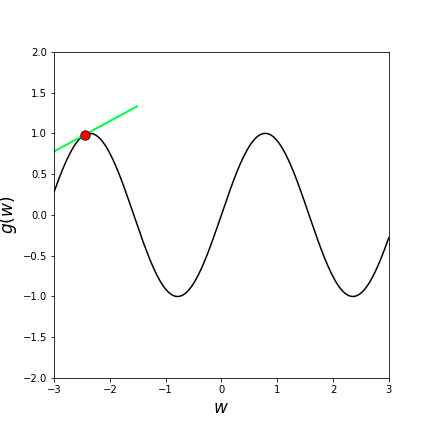
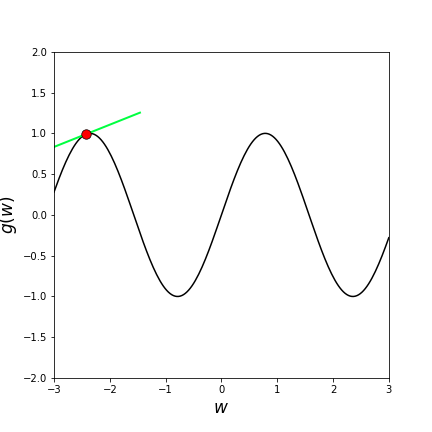
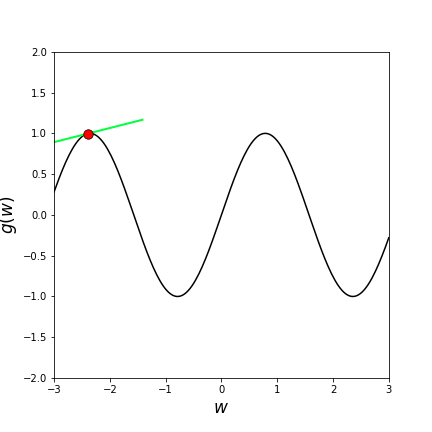
...
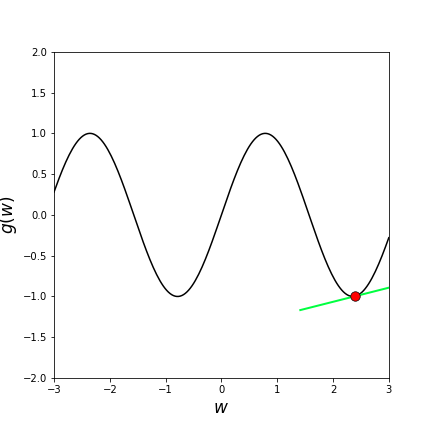
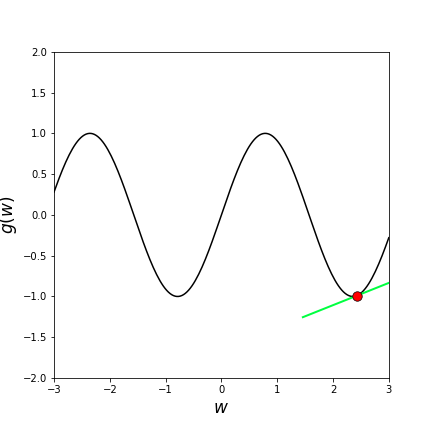
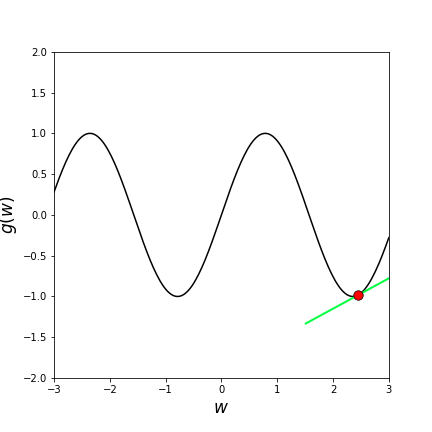
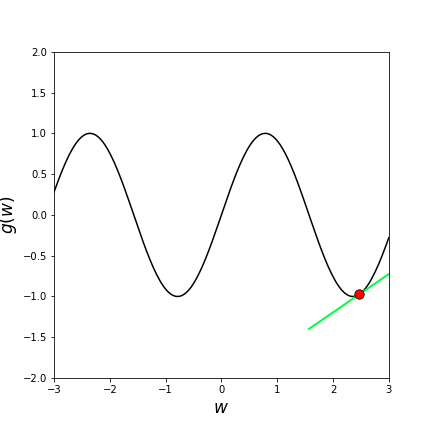
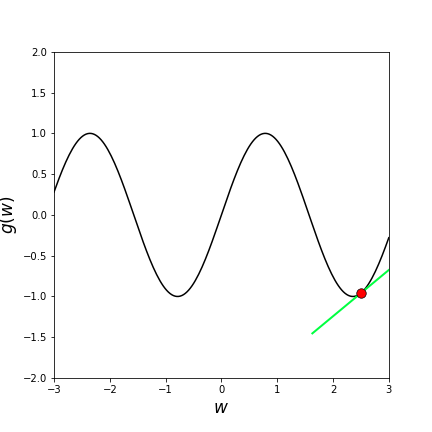

In [15]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.sin(2*w)

# create an instance of the visualizer with this function 
taylor_viz = calclib.taylor2d_viz.visualizer(g = g)

# run the visualizer for our chosen input function
taylor_viz.draw_it(first_order = True,num_frames = 200)

Then what happens if we follow the same logic - and want a simple approximator that matches the 2nd derivative too?

1.  $h(w_0) = g(w_0)$
2.  $h^{\prime}(w_0) = g^{\prime}(w_0)$
3.  $h^{(2)}(w_0) = g^{(2)}(w_0)$

\begin{equation}
h(w) = g(w_0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w_0)(w - w_0) + \frac{1}{2}\frac{\mathrm{d^2}}{\mathrm{d}w^2}g(w_0)(w - w_0)^2
\end{equation}


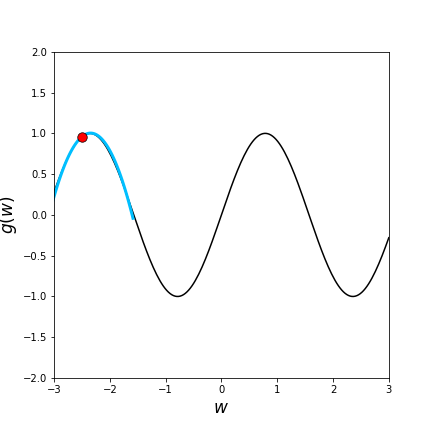
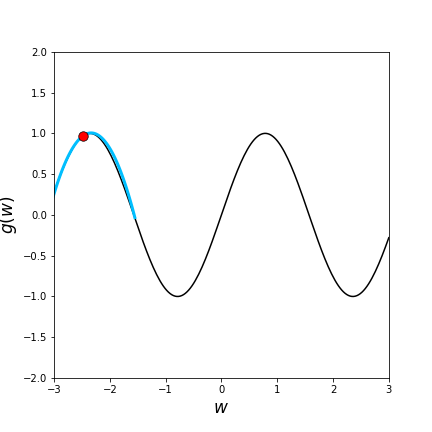
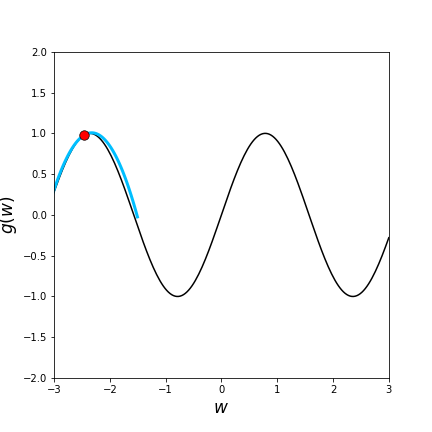
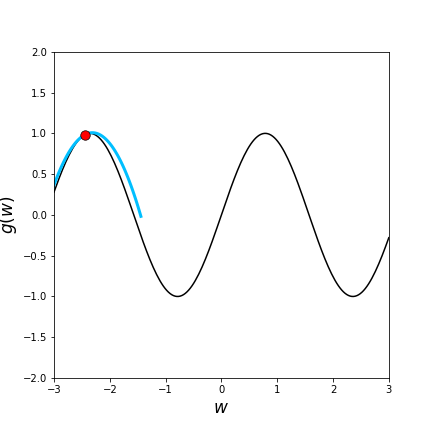
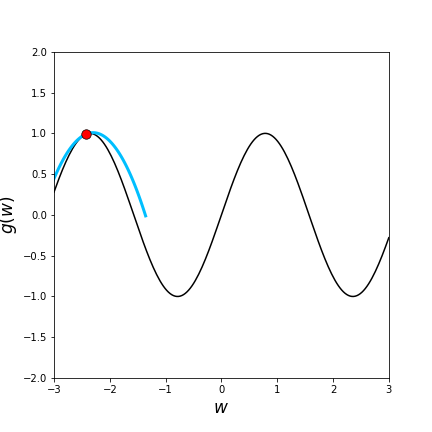
...
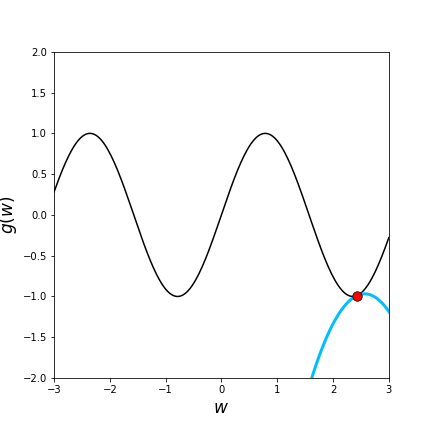
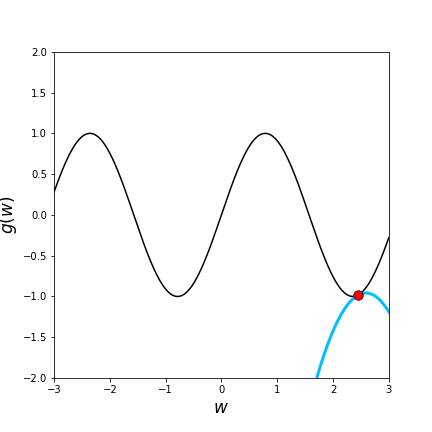
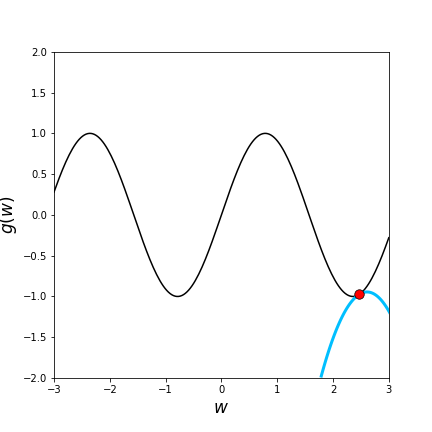
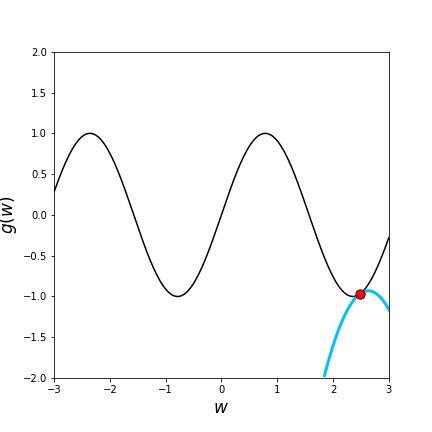
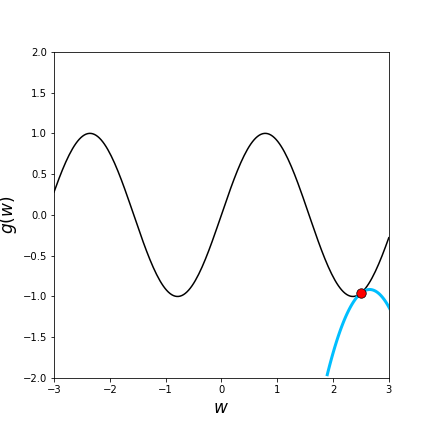

In [11]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.sin(2*w)

# create an instance of the visualizer with this function 
taylor_viz = calclib.taylor2d_viz.visualizer(g = g)

# run the visualizer for our chosen input function
taylor_viz.draw_it(second_order = True,num_frames = 300)

# General Taylor Series approximation

\begin{equation}
h(w) = g(w_0) + \frac{\mathrm{d}}{\mathrm{d}w}g(w_0)(w - w_0) + \frac{1}{2}\frac{\mathrm{d^2}}{\mathrm{d}w^2}g(w_0)(w - w_0)^2
\end{equation}

\begin{equation}
h(w) = g(w_0) + \sum_{n=1}^{n=D}\frac{1}{n!}\frac{\mathrm{d}^{(n)}}{\mathrm{d}w^{(n)}}g(w_0)(w - w_0)^{n} 
\end{equation}

### Comparing different order approximations


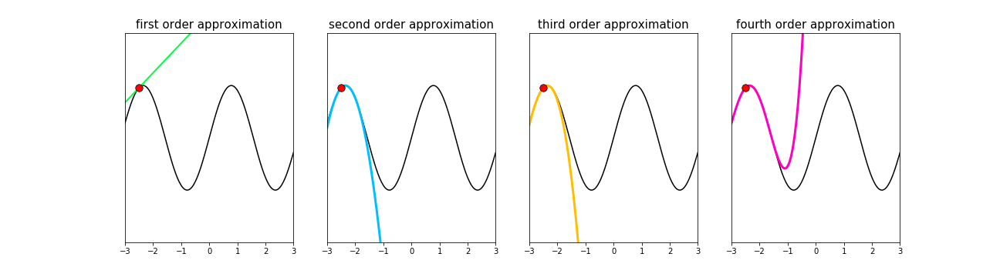
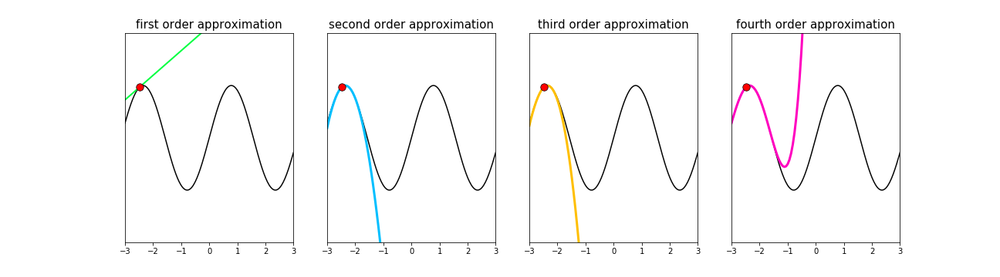
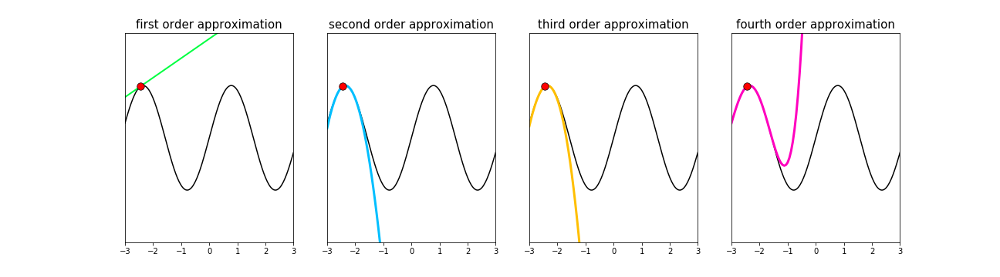
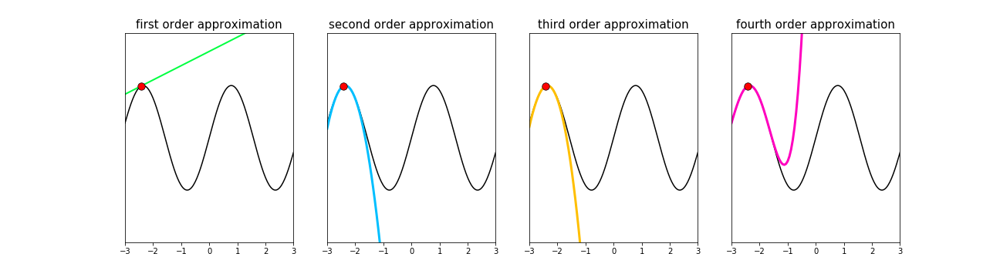
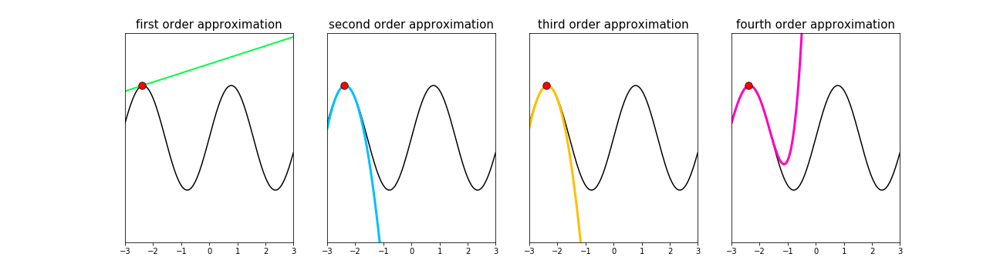
...
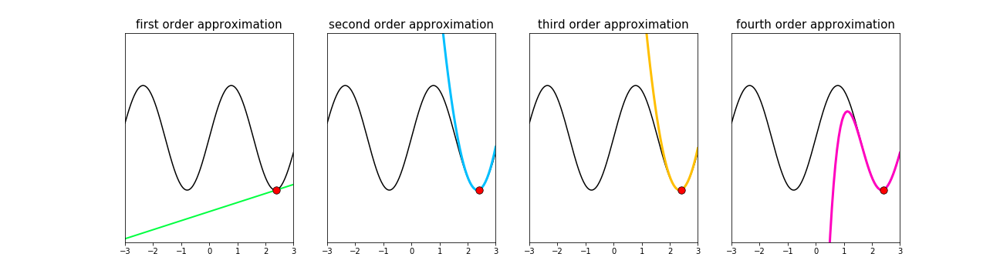
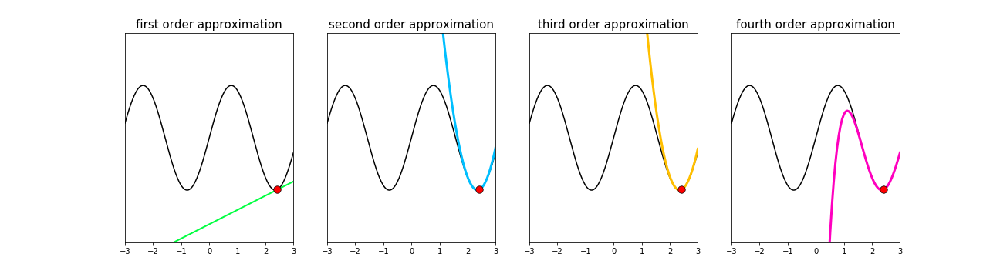
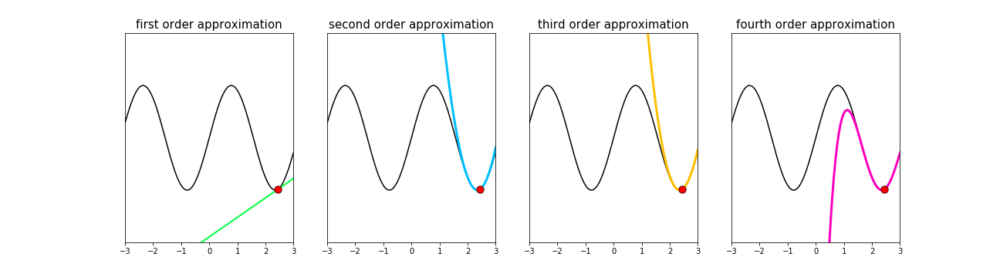
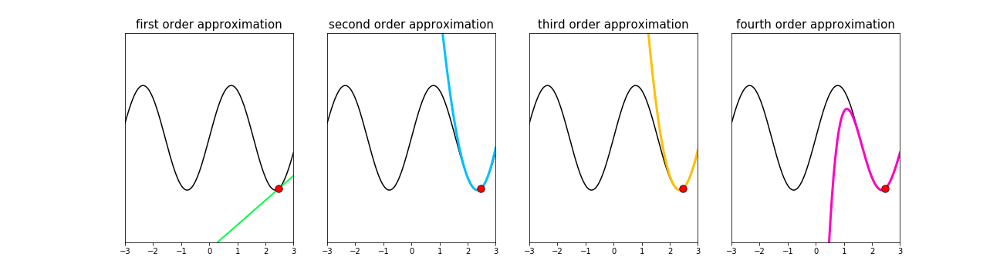
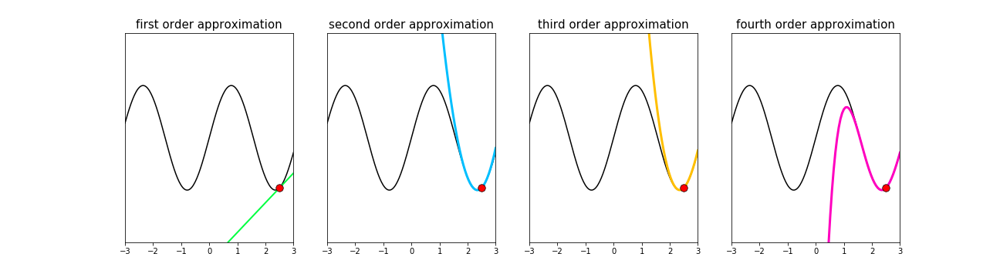

In [5]:
# what function should we play with?  Defined in the next line.
g = lambda w: np.sin(2*w)

# create an instance of the visualizer with this function 
taylor_viz = calclib.taylor_series_simultaneous_approximations.visualizer(g = g)

# run the visualizer for our chosen input function
taylor_viz.draw_it(num_frames = 200)

<blockquote style="border-left: 5px solid; border-left-color: #ccc; background: white;"><p>The content of this notebook is supplementary material for the textbook Machine Learning Refined (Cambridge University Press, 2016). Visit <a href="http://mlrefined.com">http://mlrefined.com</a> for free chapter downloads and tutorials, and <a href="https://www.amazon.com/Machine-Learning-Refined-Foundations-Applications/dp/1107123526/ref=sr_1_1?ie=UTF8&amp;qid=1474491657&amp;sr=8-1&amp;keywords=machine+learning+refined">our Amazon site</a> for details regarding a hard copy of the text.</p>
</blockquote>